## Practical Work 4

For this practical work, the student will have to develop a Python program that is able to implement the accelerated gradient descent methods with adaptive learning rate <b>(Adagrad, RMSProp, and Adam)</b> in order to achieve the linear regression of a set of datapoints.
##### Please notice that we will apply these algorithm to single variable LR.

#### Import numpy, matplotlib.pyplot and make it inline

In [1]:
import numpy as np
import matplotlib.pyplot as plt 
from sklearn.metrics import r2_score
%matplotlib inline

To have a dataset or set of data points, the student must generate a pair of arrays <b>X</b> and <b>y</b> with the values in <b>X</b> equally distributed between <b>0</b> and <b>20</b> and the values in <b>y</b> such that: 
<b>yi = a*xi + b (and a = -1, b = 2)</b>


In [2]:
X = np.linspace(0,20)
X

array([ 0.        ,  0.40816327,  0.81632653,  1.2244898 ,  1.63265306,
        2.04081633,  2.44897959,  2.85714286,  3.26530612,  3.67346939,
        4.08163265,  4.48979592,  4.89795918,  5.30612245,  5.71428571,
        6.12244898,  6.53061224,  6.93877551,  7.34693878,  7.75510204,
        8.16326531,  8.57142857,  8.97959184,  9.3877551 ,  9.79591837,
       10.20408163, 10.6122449 , 11.02040816, 11.42857143, 11.83673469,
       12.24489796, 12.65306122, 13.06122449, 13.46938776, 13.87755102,
       14.28571429, 14.69387755, 15.10204082, 15.51020408, 15.91836735,
       16.32653061, 16.73469388, 17.14285714, 17.55102041, 17.95918367,
       18.36734694, 18.7755102 , 19.18367347, 19.59183673, 20.        ])

In [3]:
a=-1
b=2
y=a*X+b
y

array([  2.        ,   1.59183673,   1.18367347,   0.7755102 ,
         0.36734694,  -0.04081633,  -0.44897959,  -0.85714286,
        -1.26530612,  -1.67346939,  -2.08163265,  -2.48979592,
        -2.89795918,  -3.30612245,  -3.71428571,  -4.12244898,
        -4.53061224,  -4.93877551,  -5.34693878,  -5.75510204,
        -6.16326531,  -6.57142857,  -6.97959184,  -7.3877551 ,
        -7.79591837,  -8.20408163,  -8.6122449 ,  -9.02040816,
        -9.42857143,  -9.83673469, -10.24489796, -10.65306122,
       -11.06122449, -11.46938776, -11.87755102, -12.28571429,
       -12.69387755, -13.10204082, -13.51020408, -13.91836735,
       -14.32653061, -14.73469388, -15.14285714, -15.55102041,
       -15.95918367, -16.36734694, -16.7755102 , -17.18367347,
       -17.59183673, -18.        ])

#### Plot X vs. y

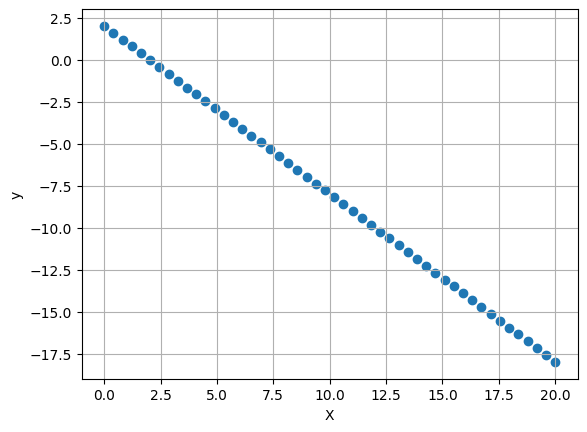

In [4]:
plt.scatter(X, y)
plt.xlabel("X")
plt.ylabel("y")
plt.grid()

## Adagrad

### For a single variable linear regression ML model, build a function to find the optimum Theta_0 and Theta_1 parameters using Adagrad optimization algorithm.
#### The funtion should have the following input parameters:
##### 1. Input data as a matrix (or vector based on your data).
##### 2. Target label as a vector.
##### 3. Learning rate.
##### 4. Epsilon.
##### 5. Maximum number of iterations (Epochs).
#### The funtion should return the following outputs:
##### 1. All predicted Theta_0 in all iterations.
##### 2. All predicted Theta_1 in all iterations.
##### 3. Corresponding loss for each Theta_0 and Theta_1 predictions.
##### 4.All hypothesis outputs (prdicted labels) for each Theta_0 and Theta_1 predictions.
##### 5.Final Optimum values of Theta_0 and Theta_1.
#### Choose the suitable number of iterations, learning rate, Epsilon, and stop criteria.
#### Calculate r2 score. Shouldn't below 0.9
#### Plot the required curves (loss-epochs, loss-theta0, loss-theta1, all fitted lines per epoch (single graph), best fit line)
#### Try different values of the huperparameters and see the differnce in your results.

In [5]:
def AdaGrad_SV(X, y, alpha, epsilon, max_iter):
    theta_0 = 0                                                     # Initialization
    theta_1 = 0
    
    thetas_0 = []
    thetas_1 = []
    
    loss = [1]
    hypos = []
    
    m = len(X)

    v0 = 0
    v1 = 0

    for i in range(max_iter):
        print('*' * 20 , f'Iteration {i}', '*' * 20, '\n')
        y_hat = theta_0 + theta_1 * X                               # Predictions
        print(f"h(x):{y_hat}\n")

        err_vec = y_hat - y                                         # Error Vector
        j = (1 / (2 * m)) * np.sum(np.square(err_vec))              # Cost Function
        print(f"Error Vector:\n{err_vec}\n\nj = {j}\n")

        #### Track variables
        loss.append(j)
        thetas_0.append(theta_0)
        thetas_1.append(theta_1)
        hypos.append(y_hat)

        d_theta_0 = (1 / m) * np.sum(err_vec * 1)                   # Theta 0 gradient
        d_theta_1 = (1 / m) * np.sum(err_vec * X)                   # Theta 1 gradient
        print(f"d_theta_0 : {d_theta_0}")
        print(f"d_theta_1 : {d_theta_1}\n")

        grad_vec = np.array([d_theta_0, d_theta_1])
        grad_norm = np.linalg.norm(grad_vec)
        print(f"Gradient Vector : {grad_vec}")
        print(f"Gradient Vector Norm : {grad_norm}\n")

        if grad_norm < .001 or np.abs((loss[-2] - loss[-1])) < .001:                                                  # Termination Condition
            print(f"Converged after {i} iteration")
            break

        v0 = v0 + d_theta_0 ** 2
        v1 = v1 + d_theta_1 ** 2

        theta_0 = theta_0 - (alpha / (np.sqrt(v0) + epsilon)) * d_theta_0                       # Theta 0 update
        theta_1 = theta_1 - (alpha / (np.sqrt(v1) + epsilon)) * d_theta_1                       # Theta 1 update


        print(f"theta_0_new : {theta_0}")
        print(f"theta_1_new : {theta_1}\n")

    loss.pop(0)
    return loss, thetas_0, thetas_1, hypos, theta_0, theta_1



In [6]:
def plot_loss(loss):
    plt.figure(figsize=(20, 7))
    plt.plot(loss, marker="o")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.grid()


def plot_all_reg(X, y, hypos):
    plt.plot(X, y, marker='o')
    for hypo in hypos:
        plt.plot(X, hypo, color='r')
    plt.grid()
    plt.xlabel("X")
    plt.ylabel("Y_pred")

def plot_best_reg(X, y, hypos):
    plt.plot(X, y, marker='o')
    plt.plot(X, hypos[-1], color='r')
    plt.grid()
    plt.xlabel("X")
    plt.ylabel("Y_pred")

def plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss):
    fig, (ax1, ax2) = plt.subplots(2, 1)
    fig.set_size_inches(7, 8)
    ax1.plot(thetas_0, loss, marker='o')
    ax1.set_xlabel("Theta 0")
    ax1.set_ylabel("Loss")
    ax1.set_title("Learning Rate = .0005")
    ax1.grid()

    ax2.plot(thetas_1, loss, marker='o')
    ax2.set_xlabel("Theta 1")
    ax2.set_ylabel("Loss")
    ax2.set_title("Learning Rate = .0005")
    ax2.grid()

    # plt.grid()
    plt.tight_layout()

##### The following results uses alpha = 0.05, epsilon =  1e-08, and max. iterations = 500.

In [7]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = AdaGrad_SV(X, y, .05, 1e-08, 500)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



Gradient Vector : [-0.11963251  7.55409365]
Gradient Vector Norm : 7.5550408864811995

theta_0_new : -0.6416330581564911
theta_1_new : -0.7484915398033019

******************** Iteration 174 ******************** 

h(x):[ -0.64163306  -0.94713981  -1.25264656  -1.55815331  -1.86366006
  -2.16916681  -2.47467356  -2.78018031  -3.08568707  -3.39119382
  -3.69670057  -4.00220732  -4.30771407  -4.61322082  -4.91872757
  -5.22423432  -5.52974107  -5.83524782  -6.14075458  -6.44626133
  -6.75176808  -7.05727483  -7.36278158  -7.66828833  -7.97379508
  -8.27930183  -8.58480858  -8.89031533  -9.19582208  -9.50132884
  -9.80683559 -10.11234234 -10.41784909 -10.72335584 -11.02886259
 -11.33436934 -11.63987609 -11.94538284 -12.25088959 -12.55639634
 -12.8619031  -13.16740985 -13.4729166  -13.77842335 -14.0839301
 -14.38943685 -14.6949436  -15.00045035 -15.3059571  -15.61146385]

Error Vector:
[-2.64163306 -2.53897654 -2.43632003 -2.33366352 -2.231007   -2.12835049
 -2.02569397 -1.92303746 -1.82038

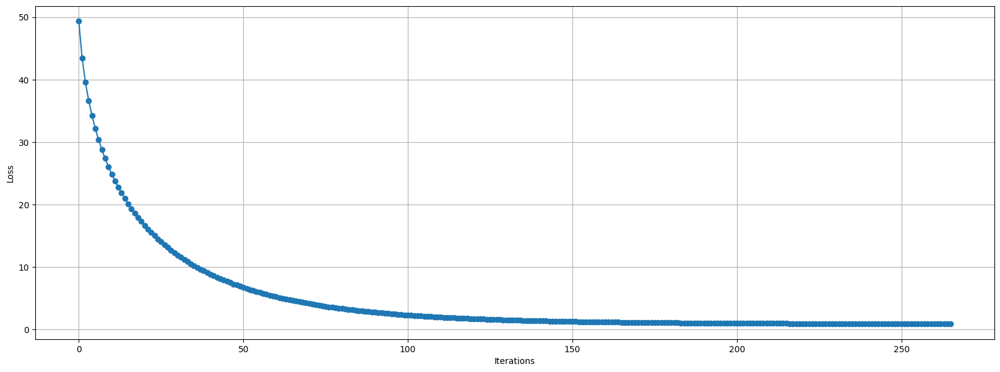

In [8]:
plot_loss(loss)

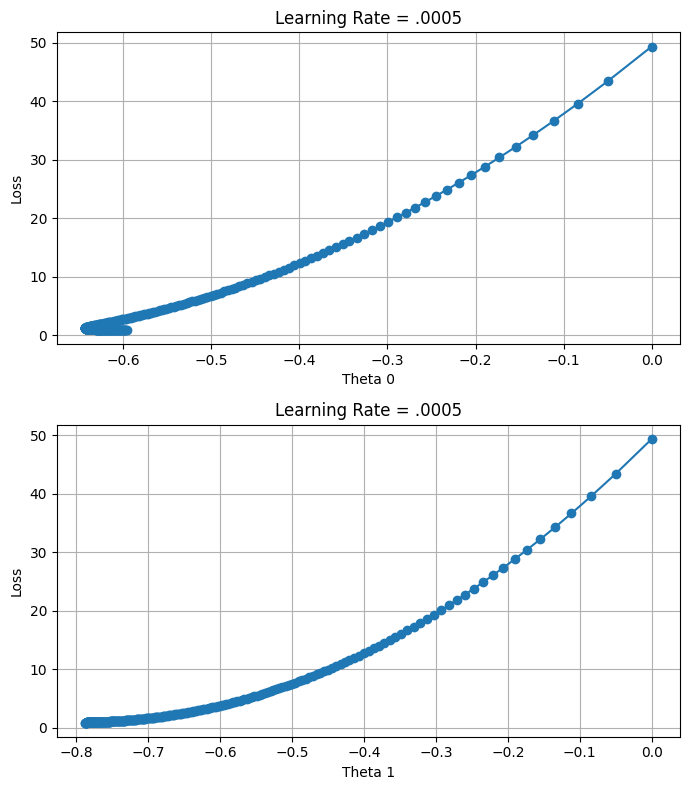

In [9]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

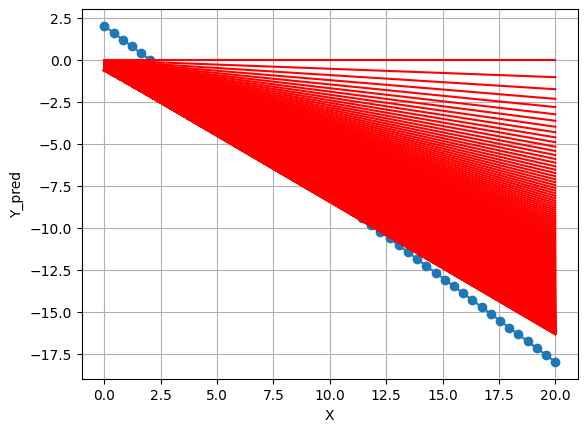

In [10]:
plot_all_reg(X, y, hypos)

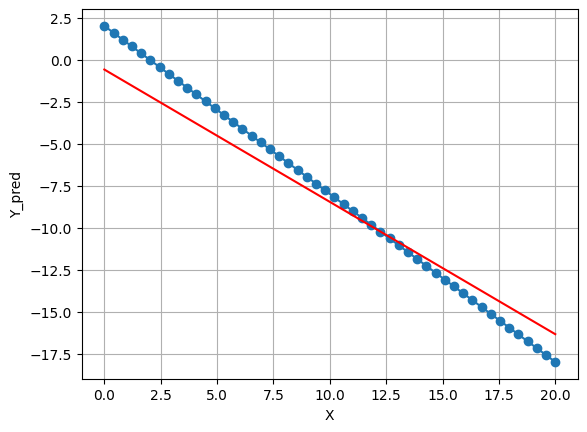

In [11]:
plot_best_reg(X, y, hypos)

##### The following results uses alpha = 0.005, epsilon =  1e-08, and max. iterations = 5000.

In [12]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = AdaGrad_SV(X, y, .005, 1e-08, 5000)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



Gradient Vector : [  7.19163163 104.06020477]
Gradient Vector Norm : 104.30841663872422

theta_0_new : -0.07395405371865632
theta_1_new : -0.07408432230707677

******************** Iteration 68 ******************** 

h(x):[-0.07395405 -0.10419255 -0.13443105 -0.16466955 -0.19490805 -0.22514655
 -0.25538505 -0.28562355 -0.31586204 -0.34610054 -0.37633904 -0.40657754
 -0.43681604 -0.46705454 -0.49729304 -0.52753154 -0.55777004 -0.58800854
 -0.61824703 -0.64848553 -0.67872403 -0.70896253 -0.73920103 -0.76943953
 -0.79967803 -0.82991653 -0.86015503 -0.89039352 -0.92063202 -0.95087052
 -0.98110902 -1.01134752 -1.04158602 -1.07182452 -1.10206302 -1.13230152
 -1.16254001 -1.19277851 -1.22301701 -1.25325551 -1.28349401 -1.31373251
 -1.34397101 -1.37420951 -1.40444801 -1.4346865  -1.464925   -1.4951635
 -1.525402   -1.5556405 ]

Error Vector:
[-2.07395405 -1.69602929 -1.31810452 -0.94017975 -0.56225499 -0.18433022
  0.19359454  0.57151931  0.94944408  1.32736884  1.70529361  2.08321838
  2.4611

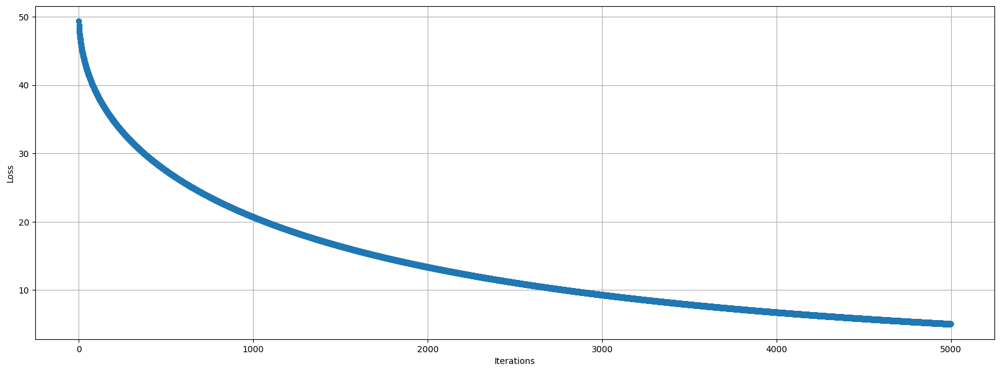

In [13]:
plot_loss(loss)

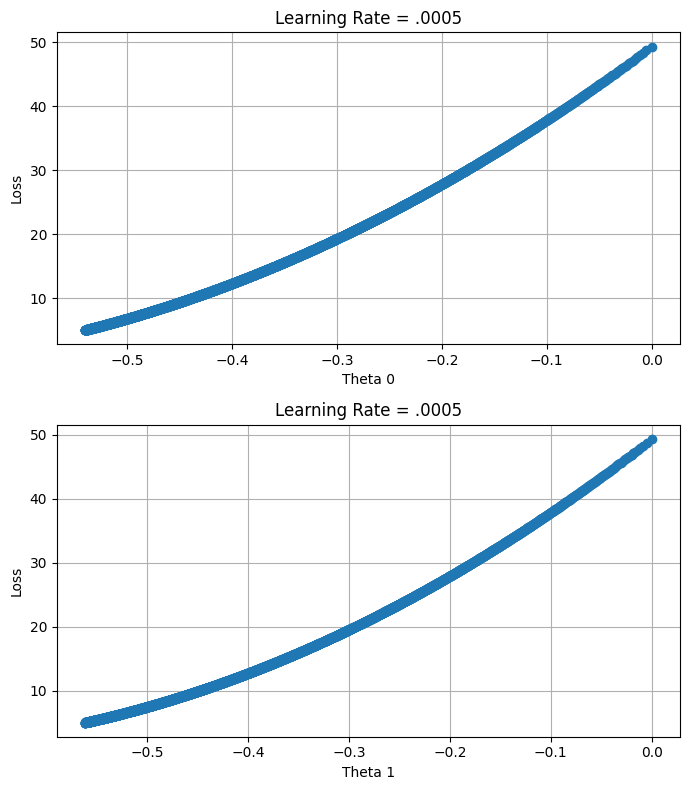

In [14]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

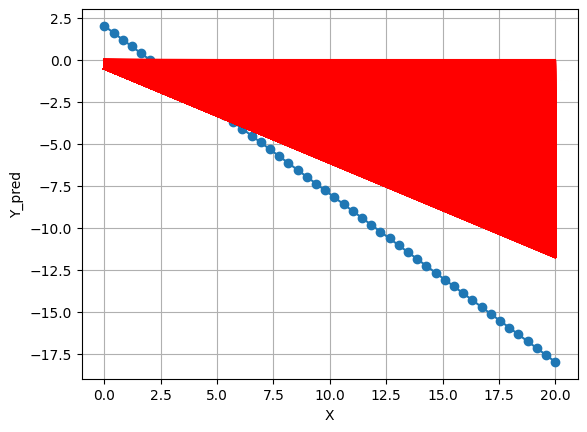

In [15]:
plot_all_reg(X, y, hypos)

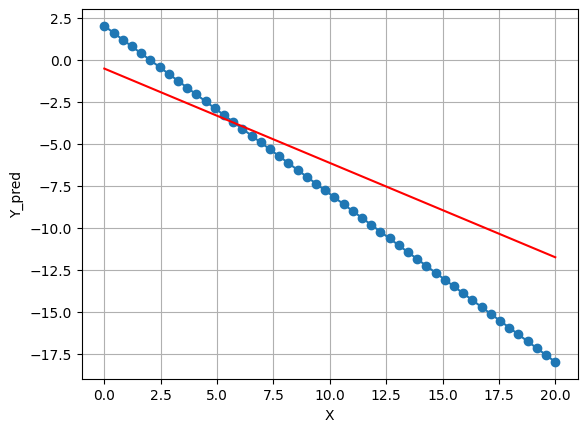

In [16]:
plot_best_reg(X, y, hypos)

In [17]:
r2_score(y, theta_0 + theta_1 * X)

0.7096780137749918

##### The following results uses alpha = 0.0005, epsilon =  1e-08, and max. iterations = 5000.

In [18]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = AdaGrad_SV(X, y, .0005, 1e-08, 5000)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



Gradient Vector : [  7.73092116 111.15437857]
Gradient Vector Norm : 111.42290167058484

theta_0_new : -0.024470008204290426
theta_1_new : -0.02448235378467677

******************** Iteration 642 ******************** 

h(x):[-0.02447001 -0.03446281 -0.0444556  -0.0544484  -0.0644412  -0.074434
 -0.08442679 -0.09441959 -0.10441239 -0.11440519 -0.12439798 -0.13439078
 -0.14438358 -0.15437638 -0.16436917 -0.17436197 -0.18435477 -0.19434757
 -0.20434036 -0.21433316 -0.22432596 -0.23431875 -0.24431155 -0.25430435
 -0.26429715 -0.27428994 -0.28428274 -0.29427554 -0.30426834 -0.31426113
 -0.32425393 -0.33424673 -0.34423953 -0.35423232 -0.36422512 -0.37421792
 -0.38421072 -0.39420351 -0.40419631 -0.41418911 -0.42418191 -0.4341747
 -0.4441675  -0.4541603  -0.4641531  -0.47414589 -0.48413869 -0.49413149
 -0.50412429 -0.51411708]

Error Vector:
[-2.02447001 -1.62629954 -1.22812907 -0.8299586  -0.43178814 -0.03361767
  0.3645528   0.76272327  1.16089373  1.5590642   1.95723467  2.35540514
  2.7535

In [19]:
r2_score(y, theta_0 + theta_1 * X)

-1.4736441832884104

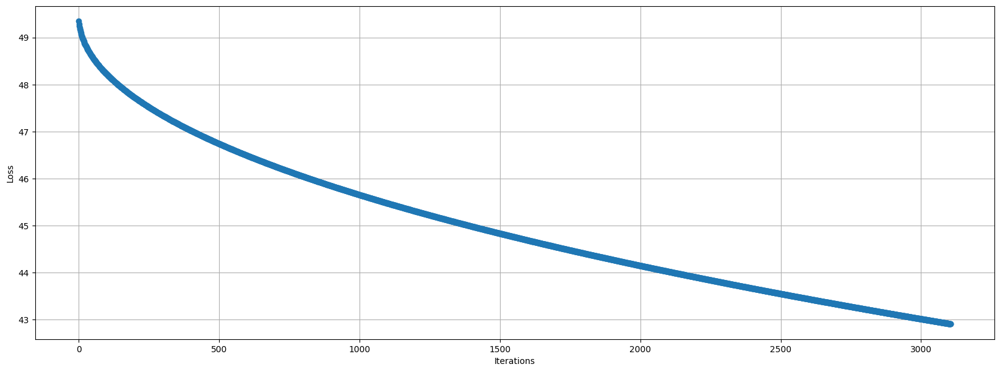

In [20]:
plot_loss(loss)

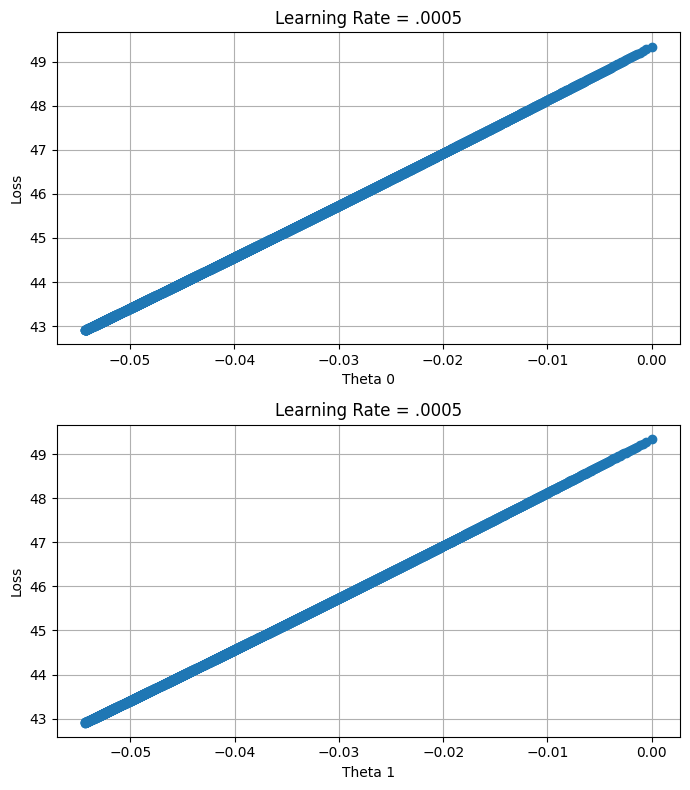

In [21]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

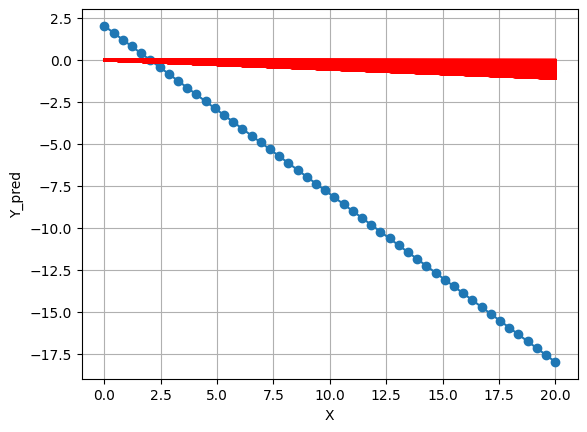

In [22]:
plot_all_reg(X, y, hypos)

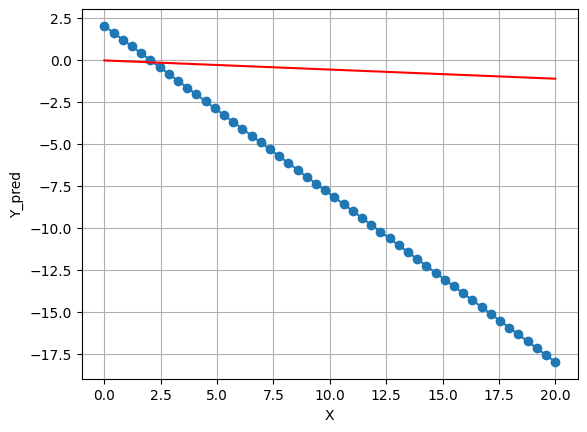

In [23]:
plot_best_reg(X, y, hypos)

## RMSProp

### Update the previos implementation to be RMSProp.
#### Compare your results with Adagrad results.

In [24]:
def RMSProp_SV(X, y, alpha, beta, epsilon, max_iter):
    theta_0 = 0                                                     # Initialization
    theta_1 = 0
    
    thetas_0 = []
    thetas_1 = []
    
    loss = [1]
    hypos = []
    
    m = len(X)

    v0 = 0
    v1 = 0

    for i in range(max_iter):
        print('*' * 20 , f'Iteration {i}', '*' * 20, '\n')
        y_hat = theta_0 + theta_1 * X                               # Predictions
        print(f"h(x):{y_hat}\n")

        err_vec = y_hat - y                                         # Error Vector
        j = (1 / (2 * m)) * np.sum(np.square(err_vec))              # Cost Function
        print(f"Error Vector:\n{err_vec}\n\nj = {j}\n")

        #### Track variables
        loss.append(j)
        thetas_0.append(theta_0)
        thetas_1.append(theta_1)
        hypos.append(y_hat)

        d_theta_0 = (1 / m) * np.sum(err_vec * 1)                   # Theta 0 gradient
        d_theta_1 = (1 / m) * np.sum(err_vec * X)                   # Theta 1 gradient
        print(f"d_theta_0 : {d_theta_0}")
        print(f"d_theta_1 : {d_theta_1}\n")

        grad_vec = np.array([d_theta_0, d_theta_1])
        grad_norm = np.linalg.norm(grad_vec)
        print(f"Gradient Vector : {grad_vec}")
        print(f"Gradient Vector Norm : {grad_norm}\n")

        if grad_norm < .001 or np.abs((loss[-2] - loss[-1])) < .001:                                                  # Termination Condition
            print(f"Converged after {i} iteration")
            break

        v0 = beta * v0 + ( 1 - beta) * d_theta_0 ** 2
        v1 = beta * v1 + ( 1 - beta) * d_theta_1 ** 2

        theta_0 = theta_0 - (alpha / (np.sqrt(v0) + epsilon)) * d_theta_0                       # Theta 0 update
        theta_1 = theta_1 - (alpha / (np.sqrt(v1) + epsilon)) * d_theta_1                       # Theta 1 update


        print(f"theta_0_new : {theta_0}")
        print(f"theta_1_new : {theta_1}\n")

    loss.pop(0)
    return loss, thetas_0, thetas_1, hypos, theta_0, theta_1



##### The following results uses alpha = 0.05, beta = 0.9, epsilon =  1e-08, and max. iterations = 500.

In [25]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = RMSProp_SV(X, y, .05, .9, 1e-08, 500)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



In [26]:
r2_score(y, theta_0 + theta_1 * X)

0.9993602095484933

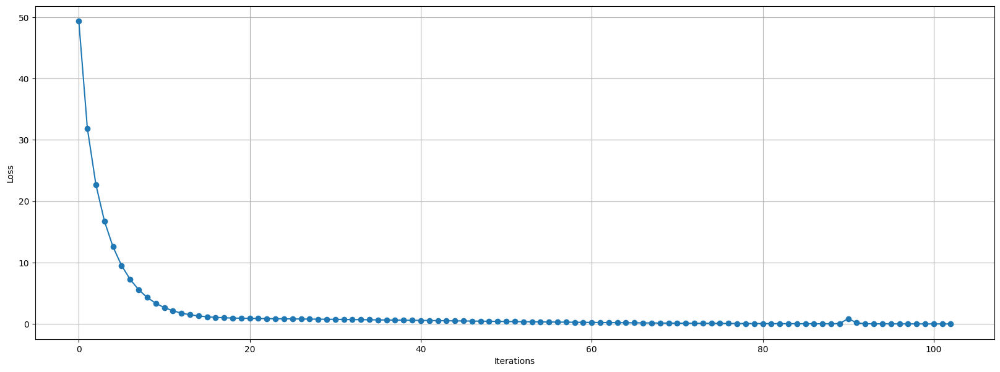

In [27]:
plot_loss(loss)

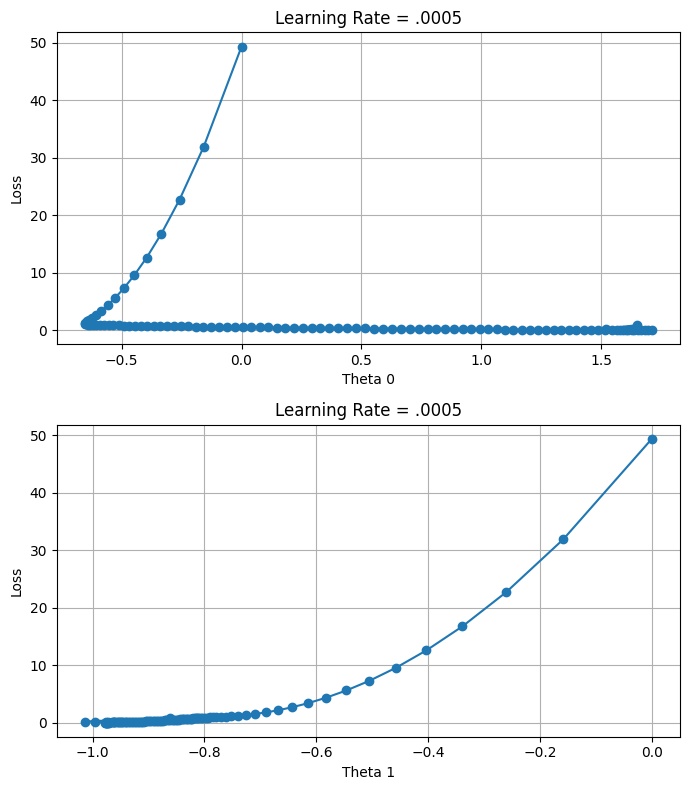

In [28]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

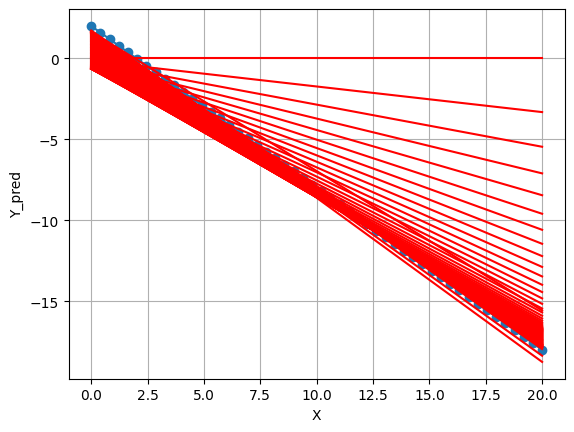

In [29]:
plot_all_reg(X, y, hypos)

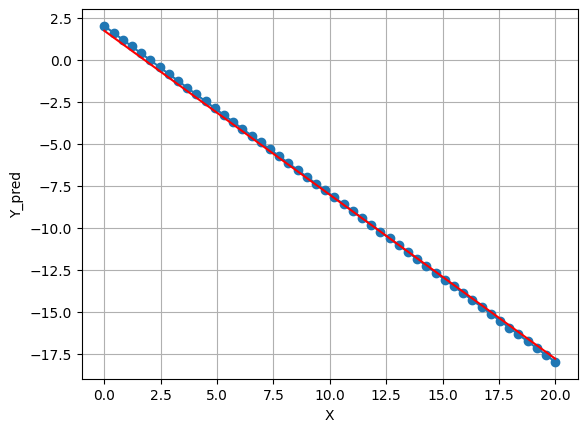

In [30]:
plot_best_reg(X, y, hypos)

##### The following results uses alpha = 0.005, beta = 0.9, epsilon =  1e-08, and max. iterations = 5000.

In [31]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = RMSProp_SV(X, y, .005, .9, 1e-08, 5000)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



Gradient Vector : [-0.56444534  0.00811628]
Gradient Vector Norm : 0.5645036909534649

theta_0_new : -0.18880924502739646
theta_1_new : -0.8374404043526271

******************** Iteration 258 ******************** 

h(x):[ -0.18880925  -0.53062165  -0.87243406  -1.21424647  -1.55605888
  -1.89787129  -2.2396837   -2.58149611  -2.92330852  -3.26512093
  -3.60693334  -3.94874575  -4.29055816  -4.63237057  -4.97418298
  -5.31599539  -5.6578078   -5.99962021  -6.34143262  -6.68324503
  -7.02505744  -7.36686985  -7.70868226  -8.05049467  -8.39230708
  -8.73411949  -9.0759319   -9.41774431  -9.75955672 -10.10136913
 -10.44318154 -10.78499395 -11.12680636 -11.46861877 -11.81043118
 -12.15224359 -12.494056   -12.83586841 -13.17768082 -13.51949323
 -13.86130564 -14.20311805 -14.54493046 -14.88674287 -15.22855528
 -15.57036769 -15.9121801  -16.25399251 -16.59580492 -16.93761733]

Error Vector:
[-2.18880925e+00 -2.12245839e+00 -2.05610753e+00 -1.98975668e+00
 -1.92340582e+00 -1.85705497e+00 -1.790

In [32]:
r2_score(y, theta_0 + theta_1 * X)

0.9948527107478715

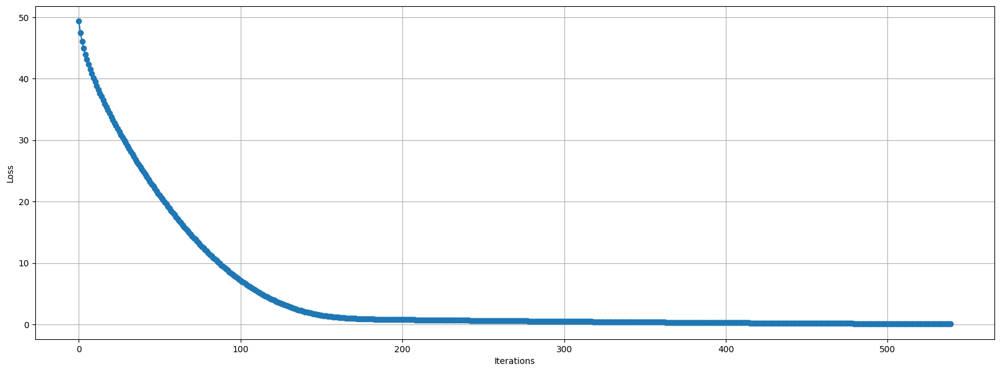

In [33]:
plot_loss(loss)

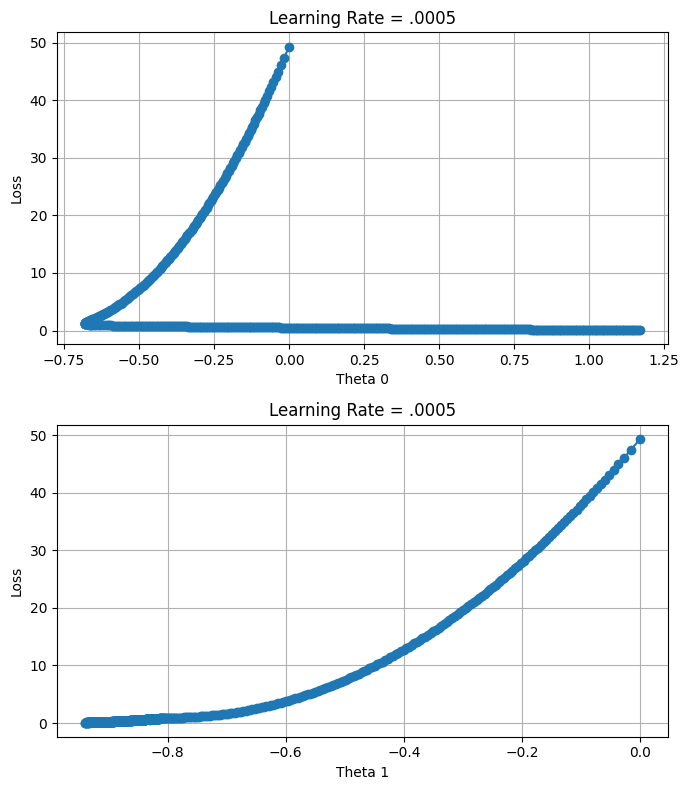

In [34]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

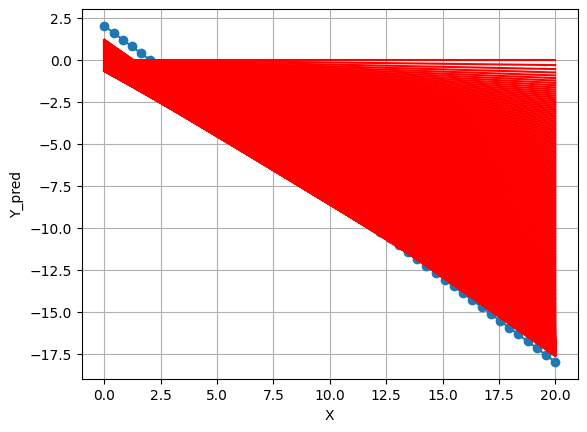

In [35]:
plot_all_reg(X, y, hypos)

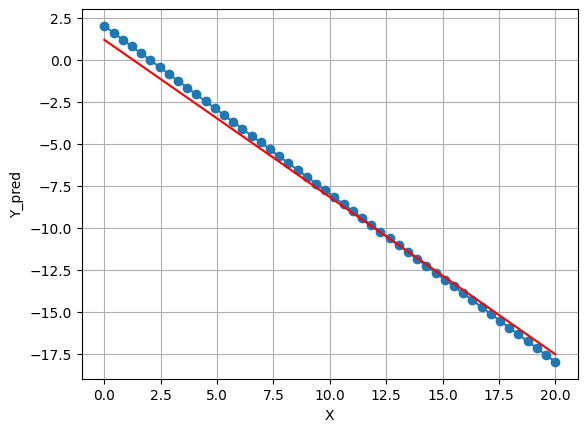

In [36]:
plot_best_reg(X, y, hypos)

##### The following results uses alpha = 0.0005, beta = 0.9, epsilon =  1e-08, and max. iterations = 5000.

In [37]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = RMSProp_SV(X, y, .0005, .9, 1e-08, 5000)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



In [38]:
r2_score(y, theta_0 + theta_1 * X)

0.9476184845511563

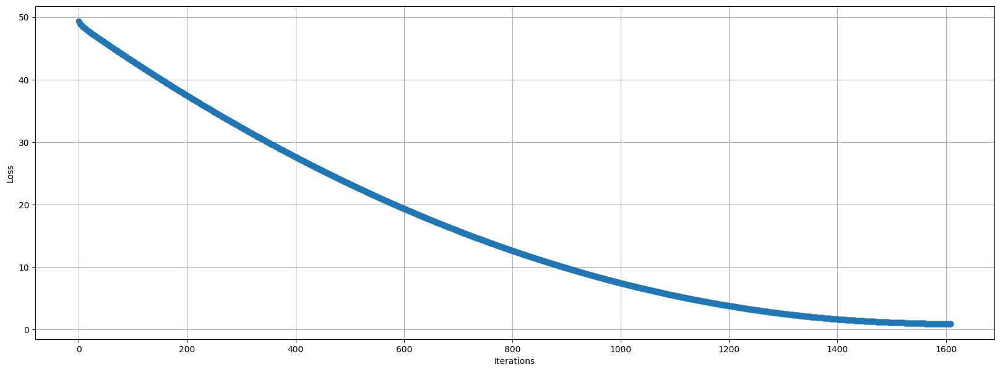

In [39]:
plot_loss(loss)

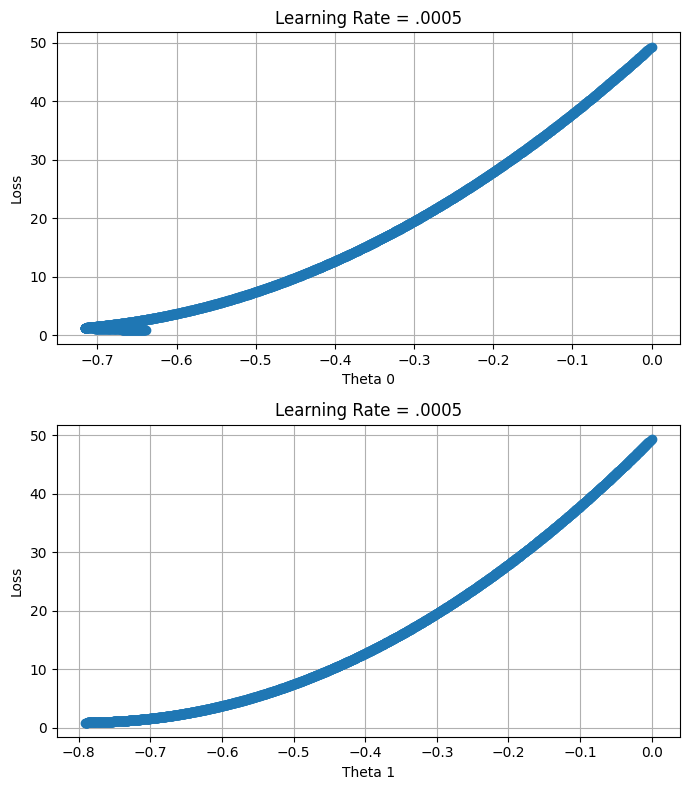

In [40]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

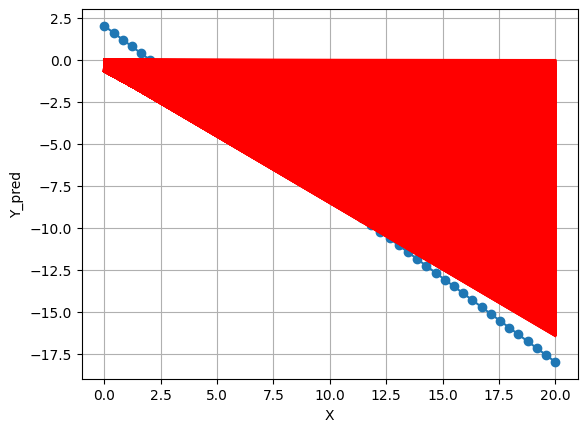

In [41]:
plot_all_reg(X, y, hypos)

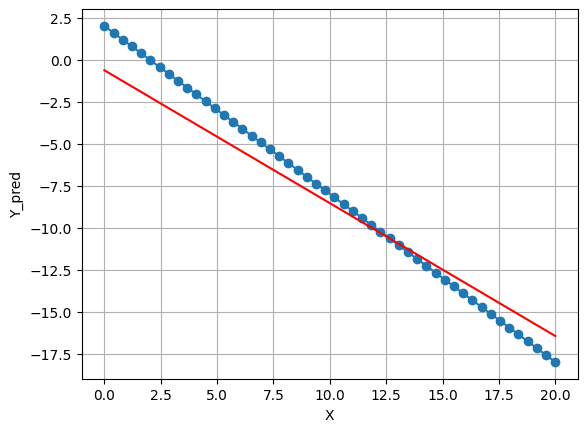

In [42]:
plot_best_reg(X, y, hypos)

## Adam

### Update the previos implementation to be Adam.
#### Compare your results with Adagrad and RMSProp results.

In [43]:
def Adam_SV(X, y, alpha, b1, b2, epsilon, max_iter):
    theta_0 = 0                                                     # Initialization
    theta_1 = 0
    
    thetas_0 = []
    thetas_1 = []
    
    loss = [1]
    hypos = []
    
    m = len(X)

    v0 = 0
    v1 = 0

    m0 = 0
    m1 = 0

    for i in range(max_iter):
        print('*' * 20 , f'Iteration {i}', '*' * 20, '\n')
        y_hat = theta_0 + theta_1 * X                               # Predictions
        print(f"h(x):{y_hat}\n")

        err_vec = y_hat - y                                         # Error Vector
        j = (1 / (2 * m)) * np.sum(np.square(err_vec))              # Cost Function
        print(f"Error Vector:\n{err_vec}\n\nj = {j}\n")

        #### Track variables
        loss.append(j)
        thetas_0.append(theta_0)
        thetas_1.append(theta_1)
        hypos.append(y_hat)

        d_theta_0 = (1 / m) * np.sum(err_vec * 1)                   # Theta 0 gradient
        d_theta_1 = (1 / m) * np.sum(err_vec * X)                   # Theta 1 gradient
        print(f"d_theta_0 : {d_theta_0}")
        print(f"d_theta_1 : {d_theta_1}\n")

        grad_vec = np.array([d_theta_0, d_theta_1])
        grad_norm = np.linalg.norm(grad_vec)
        print(f"Gradient Vector : {grad_vec}")
        print(f"Gradient Vector Norm : {grad_norm}\n")

        if grad_norm < .001 or np.abs((loss[-2] - loss[-1])) < .001:                                                  # Termination Condition
            print(f"Converged after {i} iteration")
            break

        m0 = b1 * m0 + ( 1 - b1) * d_theta_0
        m1 = b1 * m1 + ( 1 - b1) * d_theta_1

        v0 = b2 * v0 + ( 1 - b2) * d_theta_0 ** 2
        v1 = b2 * v1 + ( 1 - b2) * d_theta_1 ** 2

        m0_b = m0 / (1 - b1 ** (i + 1))
        m1_b = m1 / (1 - b1 ** (i + 1))

        v0_b = v0 / (1 - b2 ** (i + 1))
        v1_b = v1 / (1 - b2 ** (i + 1))

        theta_0 = theta_0 - (alpha / (np.sqrt(v0_b) + epsilon)) * m0_b                       # Theta 0 update
        theta_1 = theta_1 - (alpha / (np.sqrt(v1_b) + epsilon)) * m1_b                       # Theta 1 update


        print(f"theta_0_new : {theta_0}")
        print(f"theta_1_new : {theta_1}\n")

    loss.pop(0)
    return loss, thetas_0, thetas_1, hypos, theta_0, theta_1



##### The following results uses alpha = 0.05, beta1 = 0.2, beta2 = 0.7, epsilon =  1e-08, and max. iterations = 500.

In [44]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = Adam_SV(X, y, .05, .2, .7, 1e-08, 500)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



In [45]:
r2_score(y, theta_0 + theta_1 * X)

0.9989675218213928

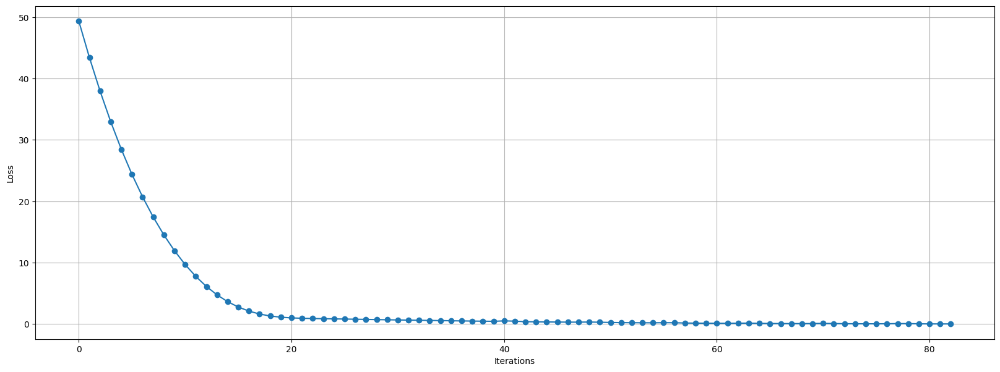

In [46]:
plot_loss(loss)

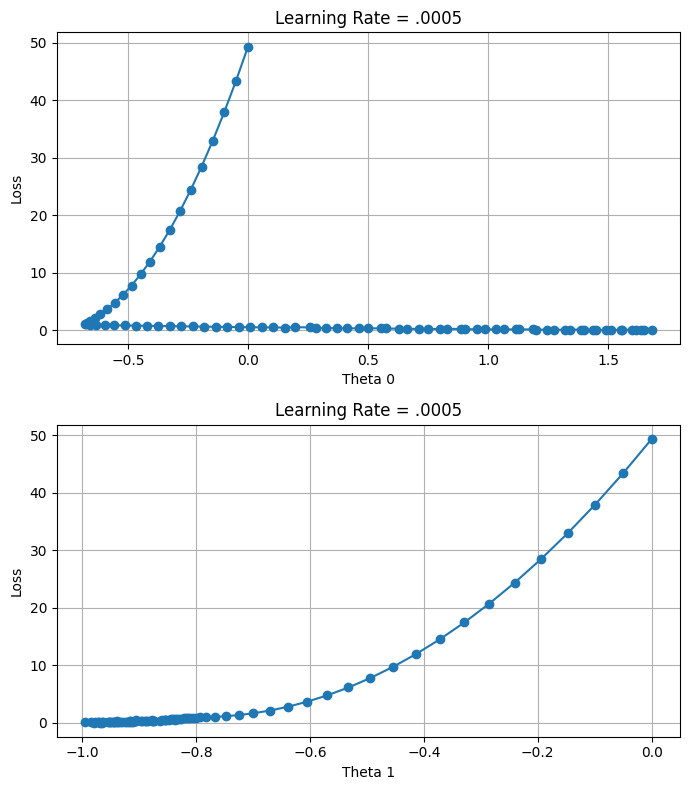

In [47]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

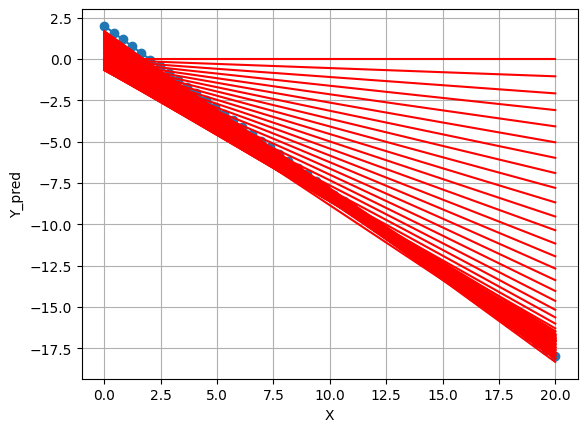

In [48]:
plot_all_reg(X, y, hypos)

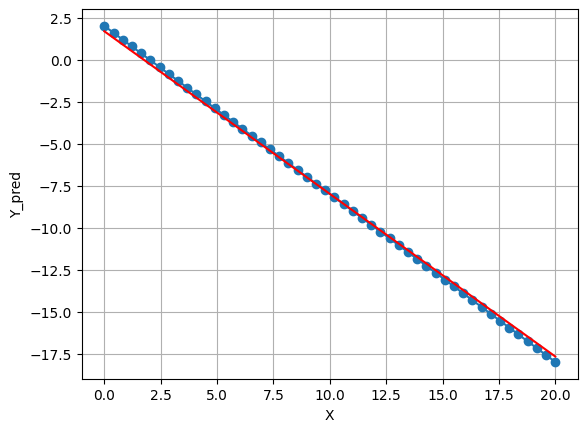

In [49]:
plot_best_reg(X, y, hypos)

In [50]:
r2_score(y, theta_0 + theta_1 * X)

0.9989675218213928

##### The following results uses alpha = 0.005, beta1 = 0.5, beta2 = 0.8, epsilon =  1e-08, and max. iterations = 500.

In [51]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = Adam_SV(X, y, .005, .5, .8, 1e-08, 500)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



In [52]:
r2_score(y, theta_0 + theta_1 * X)

0.9927017859640472

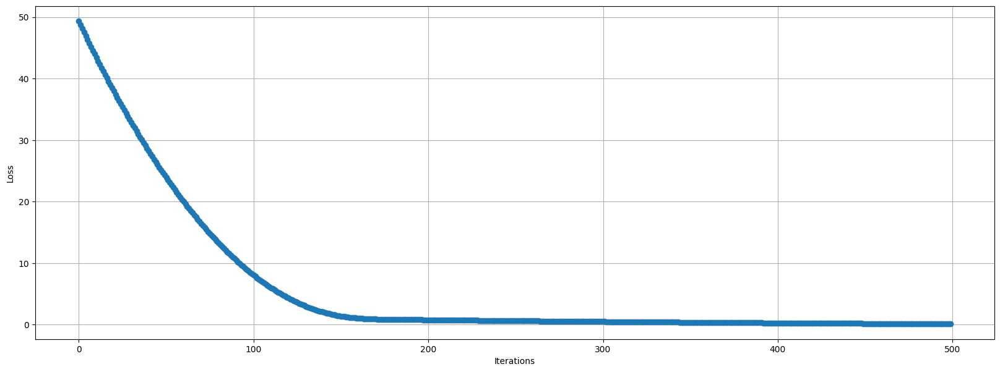

In [53]:
plot_loss(loss)

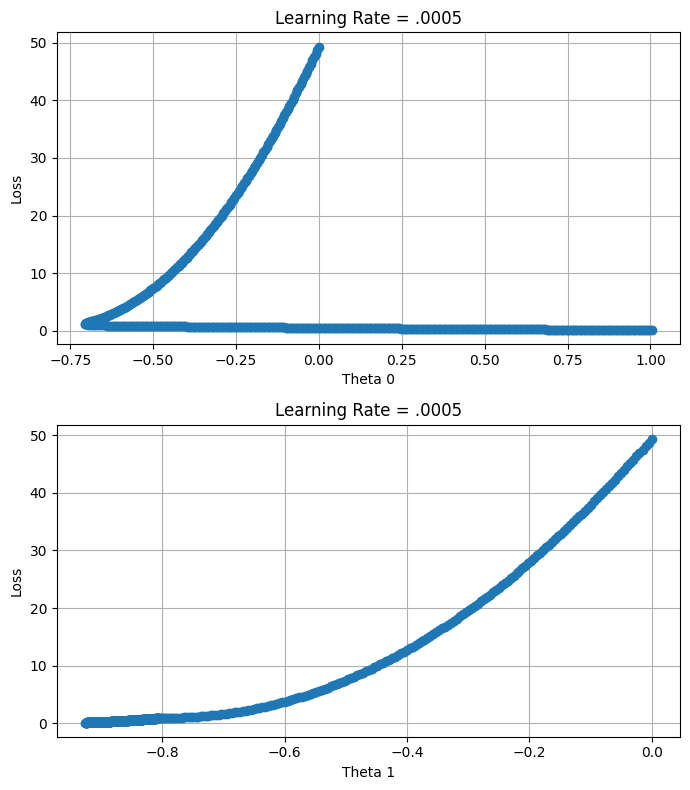

In [54]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

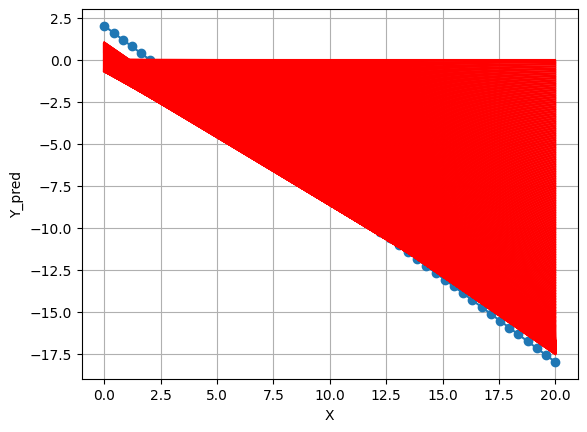

In [55]:
plot_all_reg(X, y, hypos)

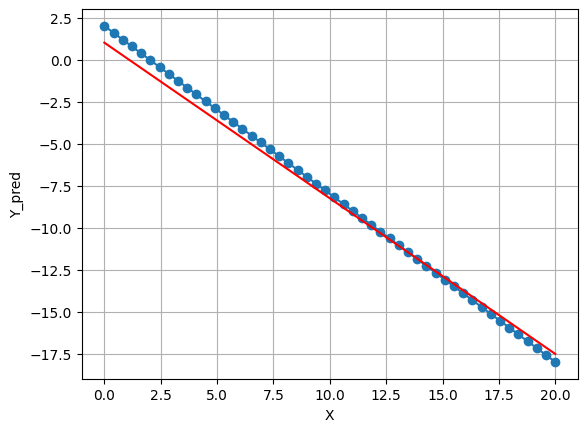

In [56]:
plot_best_reg(X, y, hypos)

##### The following results uses alpha = 0.0005, beta1 = 0.8, beta2 = 0.8, epsilon =  1e-08, and max. iterations = 5000.

In [57]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = Adam_SV(X, y, .0005, .8, .8, 1e-08, 5000)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



In [58]:
r2_score(y, theta_0 + theta_1 * X)

0.9467806664066584

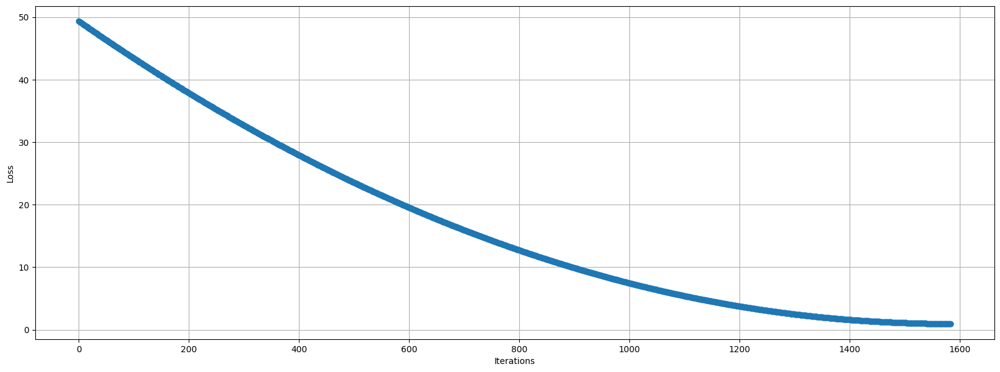

In [59]:
plot_loss(loss)

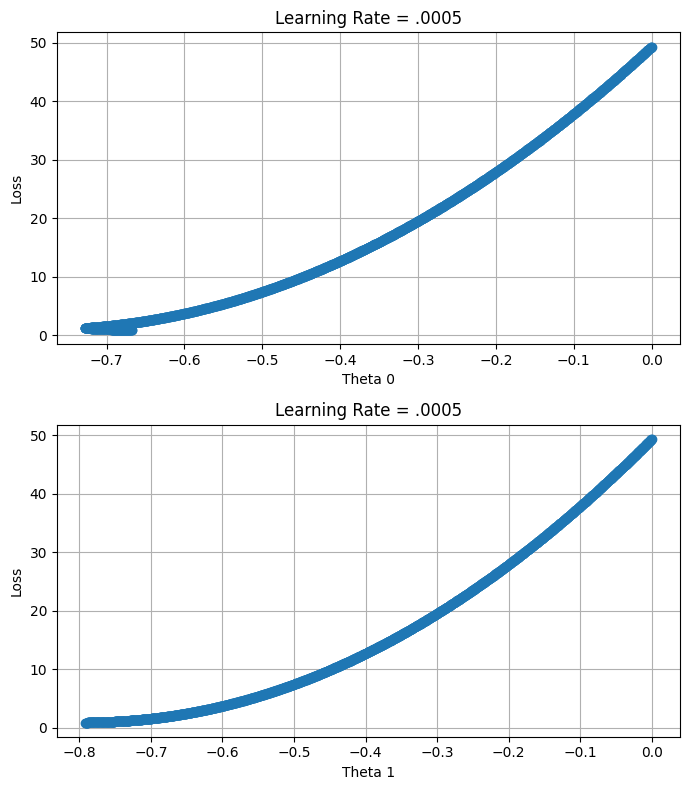

In [60]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

In [61]:
plot_all_reg(X, y, hypos)

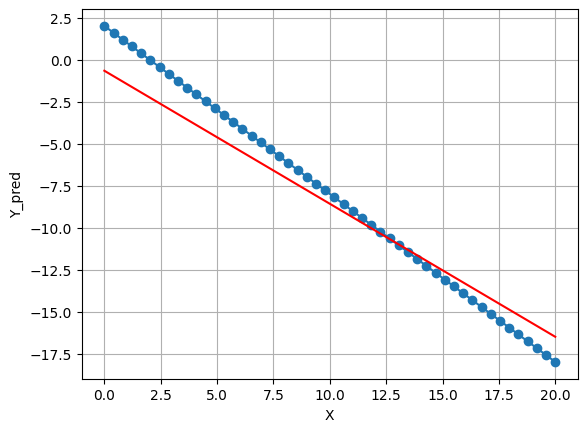

In [ ]:
plot_best_reg(X, y, hypos)

### Play with the parameters and see the results

##### The following results uses alpha = 0.001, beta1 = 0.9, beta2 = 0.99, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = Adam_SV(X, y, .001, .9, .99, 1e-08, 5000)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



In [ ]:
r2_score(y, theta_0 + theta_1 * X)

0.9485667803280174

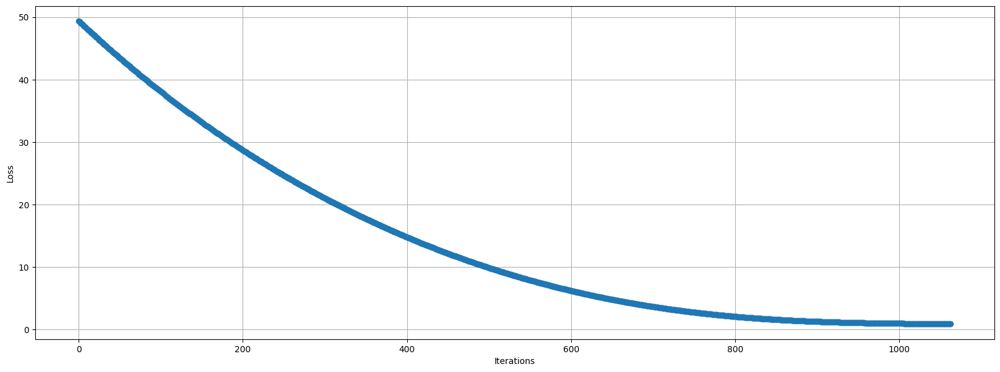

In [ ]:
plot_loss(loss)

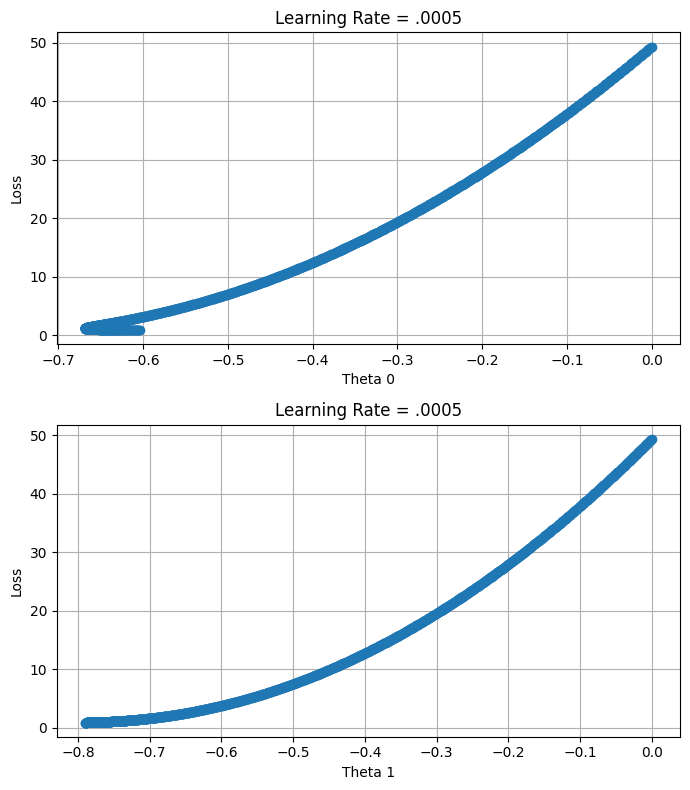

In [ ]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

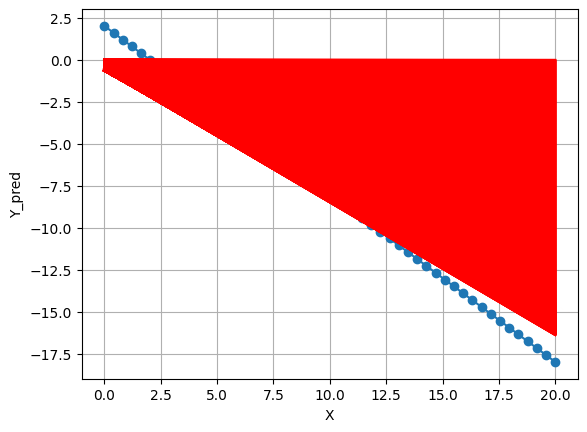

In [ ]:
plot_all_reg(X, y, hypos)

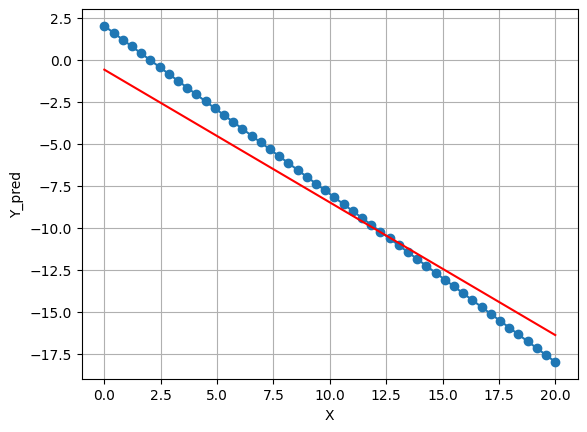

In [ ]:
plot_best_reg(X, y, hypos)

##### The following results uses alpha = 0.001, beta1 = 0.9, beta2 = 0.5, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = Adam_SV(X, y, .001, .9, .5, 1e-08, 5000)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



Gradient Vector : [ 6.08808584 89.54516967]
Gradient Vector Norm : 89.75189245654431

theta_0_new : -0.17499496194992123
theta_1_new : -0.17480645123980118

******************** Iteration 173 ******************** 

h(x):[-0.17499496 -0.24634453 -0.31769411 -0.38904368 -0.46039325 -0.53174282
 -0.60309239 -0.67444197 -0.74579154 -0.81714111 -0.88849068 -0.95984025
 -1.03118983 -1.1025394  -1.17388897 -1.24523854 -1.31658811 -1.38793768
 -1.45928726 -1.53063683 -1.6019864  -1.67333597 -1.74468554 -1.81603512
 -1.88738469 -1.95873426 -2.03008383 -2.1014334  -2.17278298 -2.24413255
 -2.31548212 -2.38683169 -2.45818126 -2.52953084 -2.60088041 -2.67222998
 -2.74357955 -2.81492912 -2.8862787  -2.95762827 -3.02897784 -3.10032741
 -3.17167698 -3.24302656 -3.31437613 -3.3857257  -3.45707527 -3.52842484
 -3.59977441 -3.67112399]

Error Vector:
[-2.17499496 -1.83818127 -1.50136758 -1.16455388 -0.82774019 -0.4909265
 -0.1541128   0.18270089  0.51951459  0.85632828  1.19314197  1.52995567
  1.866769

In [ ]:
r2_score(y, theta_0 + theta_1 * X)

0.944245878919177

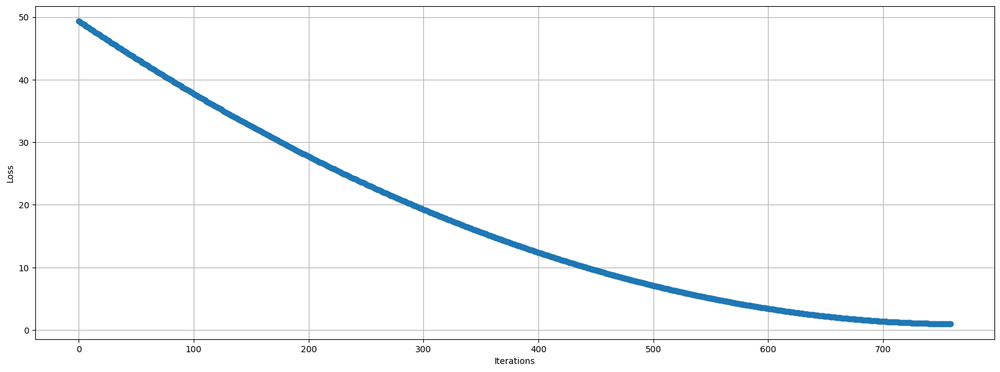

In [ ]:
plot_loss(loss)

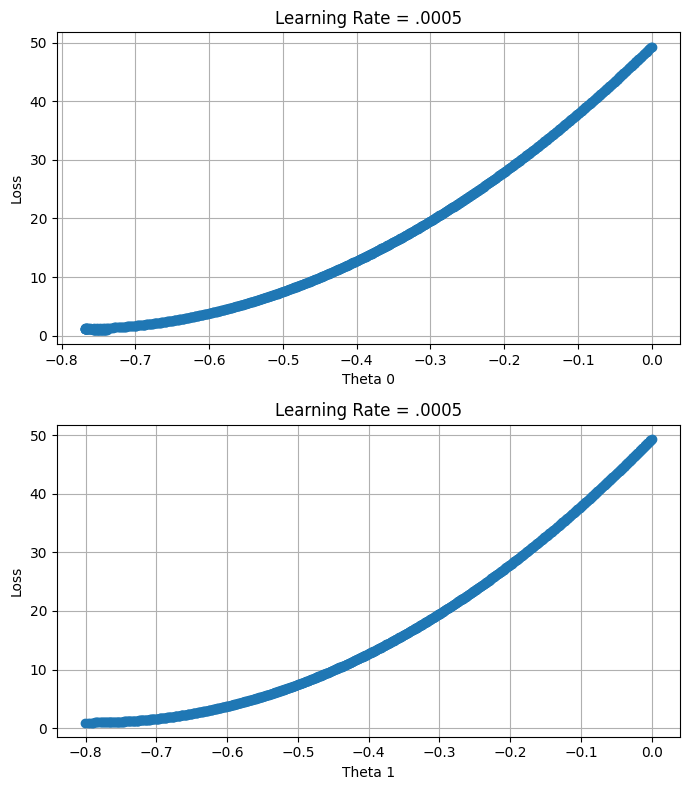

In [ ]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

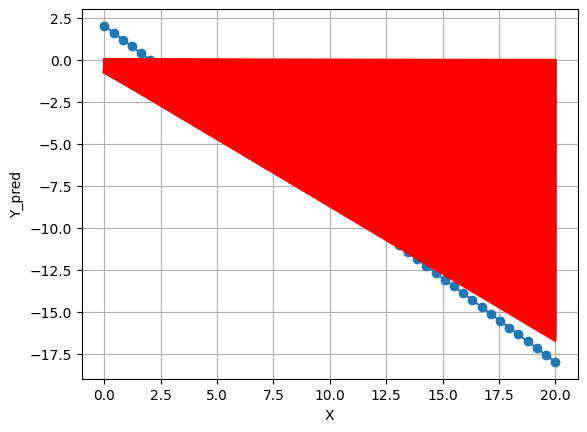

In [ ]:
plot_all_reg(X, y, hypos)

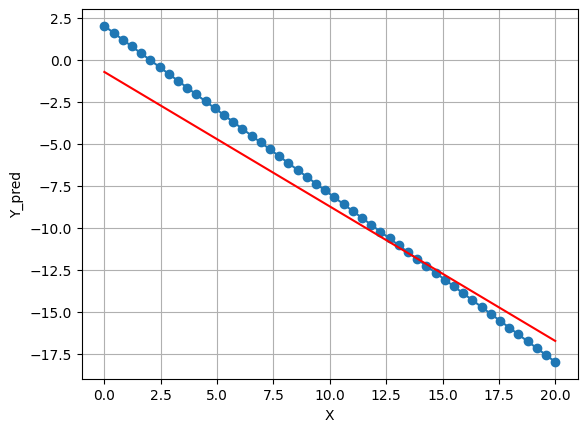

In [ ]:
plot_best_reg(X, y, hypos)

##### The following results uses alpha = 0.001, beta1 = 0.5, beta2 = 0.99, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = Adam_SV(X, y, .001, .5, .99, 1e-08, 5000)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



In [ ]:
r2_score(y, theta_0 + theta_1 * X)

0.949344733641701

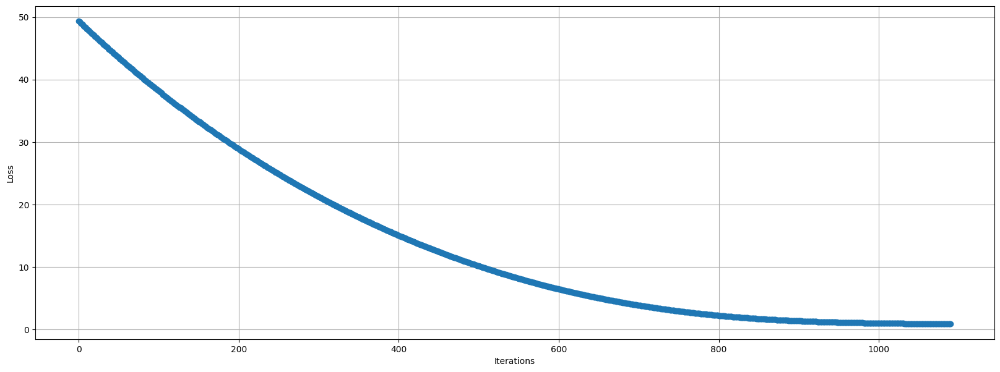

In [ ]:
plot_loss(loss)

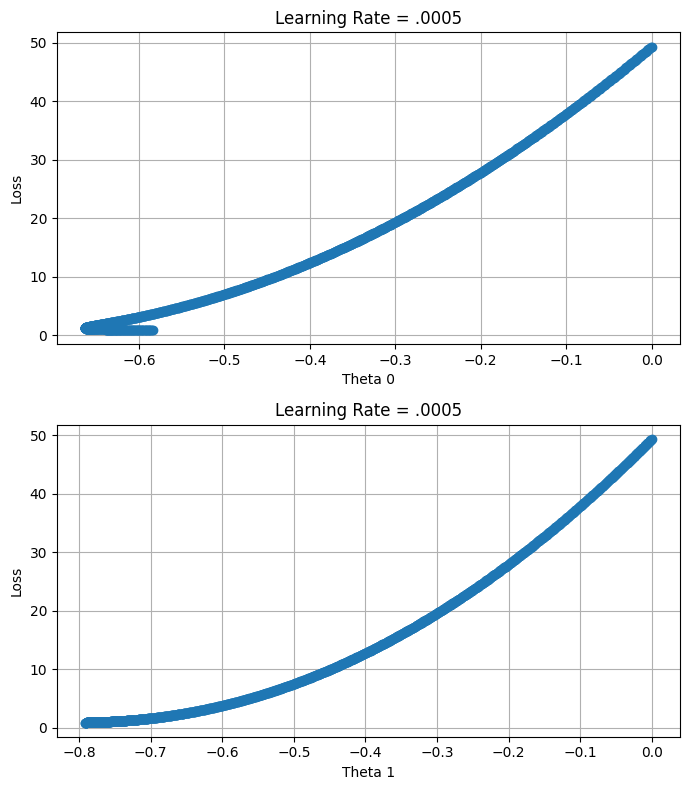

In [ ]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

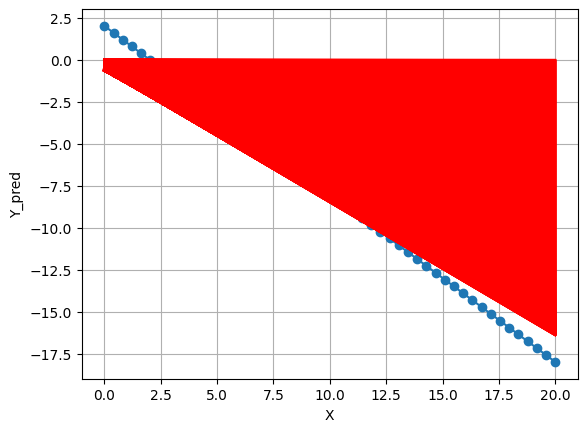

In [ ]:
plot_all_reg(X, y, hypos)

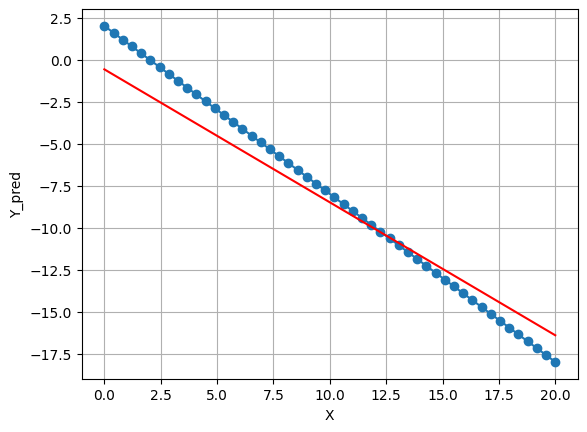

In [ ]:
plot_best_reg(X, y, hypos)

##### The following results uses alpha = 0.001, beta1 = 0.5, beta2 = 0.5, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = Adam_SV(X, y, .001, .5, .5, 1e-08, 5000)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



In [ ]:
r2_score(y, theta_0 + theta_1 * X)

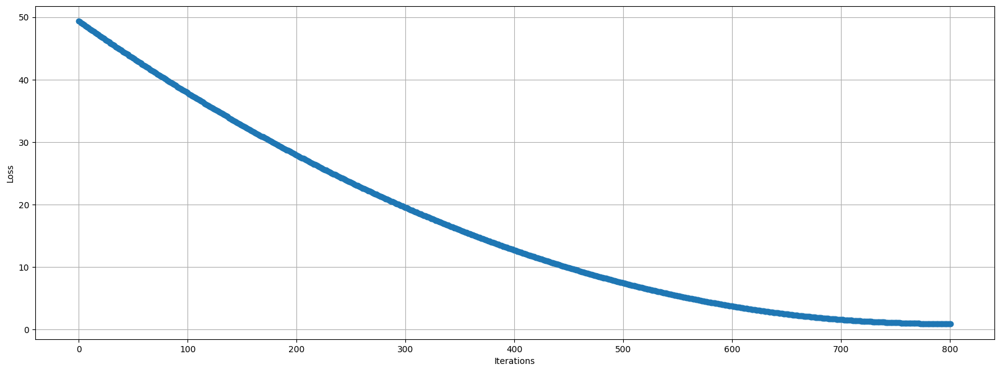

In [ ]:
plot_loss(loss)

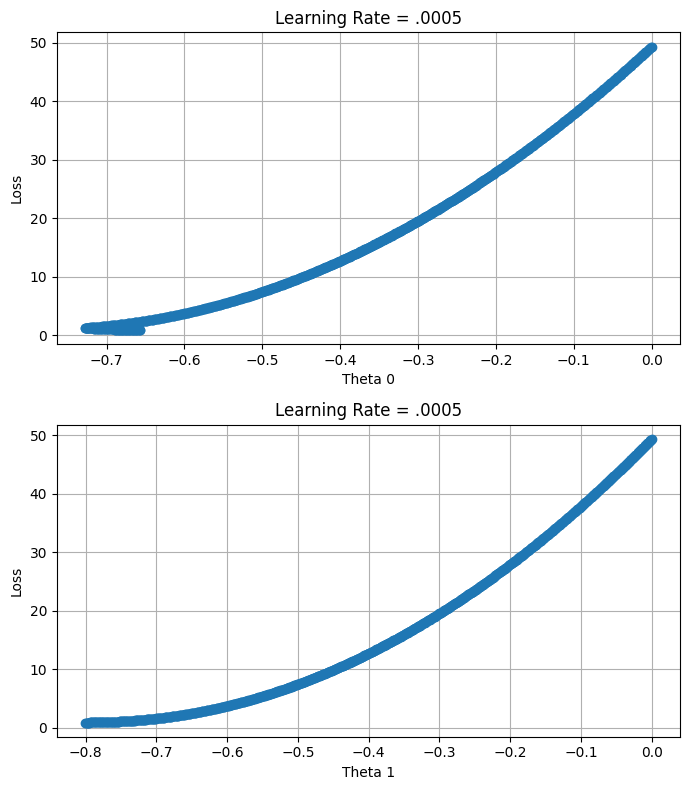

In [ ]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

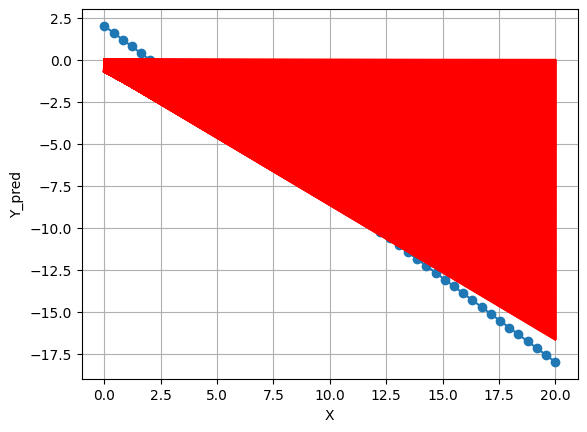

In [ ]:
plot_all_reg(X, y, hypos)

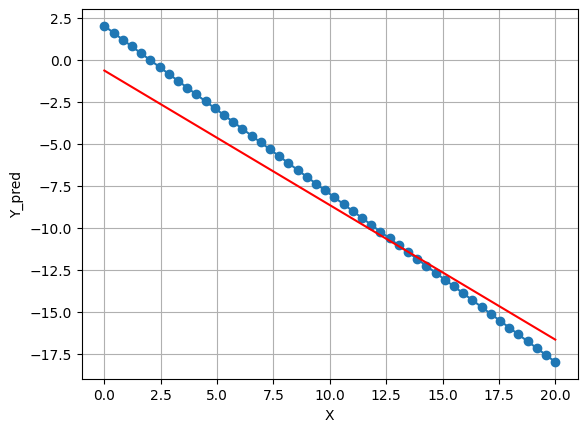

In [ ]:
plot_best_reg(X, y, hypos)

##### The following results uses alpha = 0.01, beta1 = 0.9, beta2 = 0.99, epsilon =  1e-08, and max. iterations = 5000.

In [ ]:
loss, thetas_0, thetas_1, hypos, theta_0, theta_1 = Adam_SV(X, y, .01, .9, .99, 1e-08, 5000)

******************** Iteration 0 ******************** 

h(x):[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]

Error Vector:
[-2.         -1.59183673 -1.18367347 -0.7755102  -0.36734694  0.04081633
  0.44897959  0.85714286  1.26530612  1.67346939  2.08163265  2.48979592
  2.89795918  3.30612245  3.71428571  4.12244898  4.53061224  4.93877551
  5.34693878  5.75510204  6.16326531  6.57142857  6.97959184  7.3877551
  7.79591837  8.20408163  8.6122449   9.02040816  9.42857143  9.83673469
 10.24489796 10.65306122 11.06122449 11.46938776 11.87755102 12.28571429
 12.69387755 13.10204082 13.51020408 13.91836735 14.32653061 14.73469388
 15.14285714 15.55102041 15.95918367 16.36734694 16.7755102  17.18367347
 17.59183673 18.        ]

j = 49.34693877551021

d_theta_0 : 8.0
d_theta_1 : 114.69387755102042

Gradient Vector : [  8.         114.69387755]
Gradient Vector Norm : 114.97254258164628



In [ ]:
r2_score(y, theta_0 + theta_1 * X)

0.9952892444628807

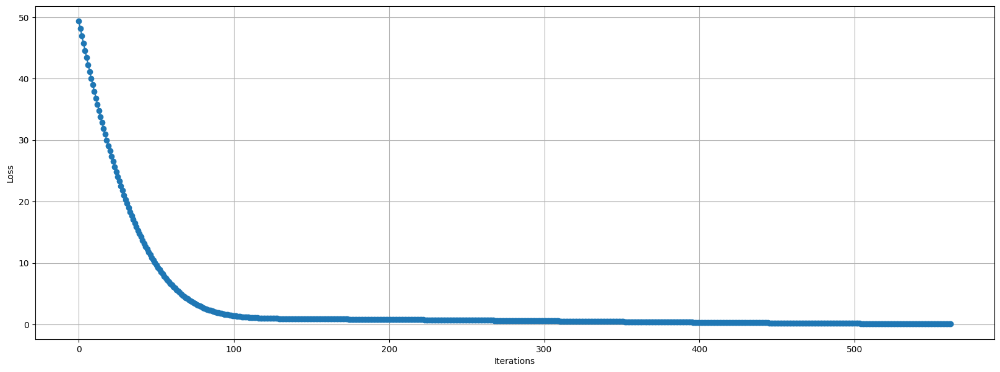

In [ ]:
plot_loss(loss)

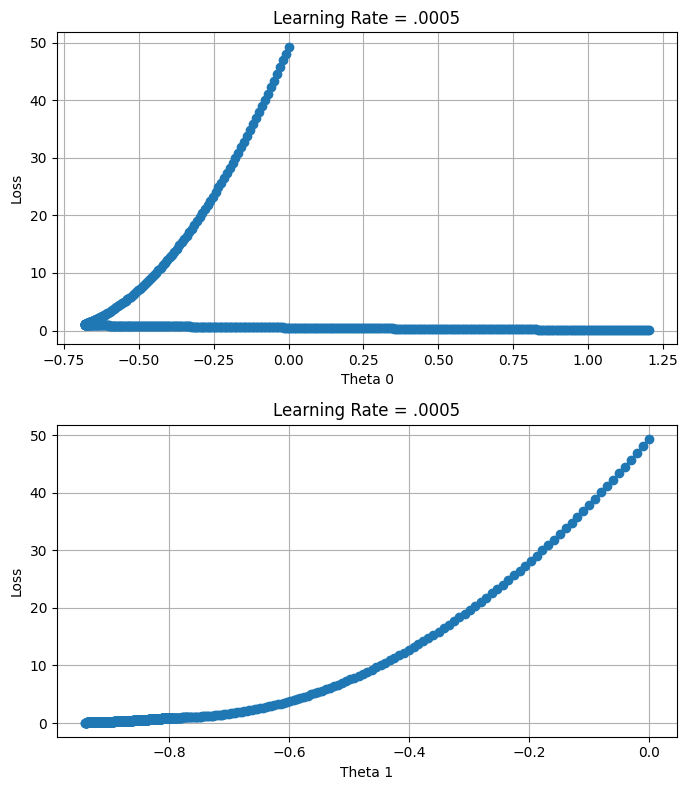

In [ ]:
plot_thetas_0_1_vs_loss(thetas_0, thetas_1, loss)

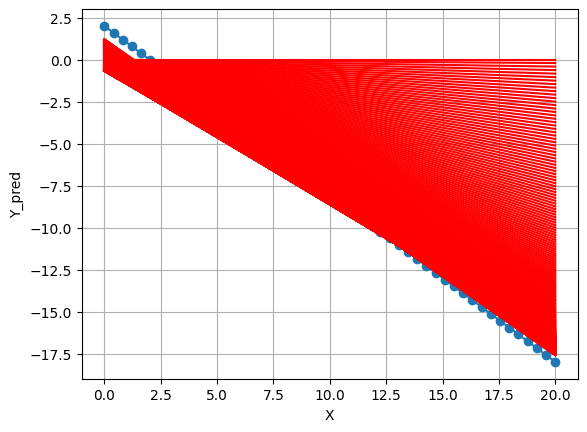

In [ ]:
plot_all_reg(X, y, hypos)

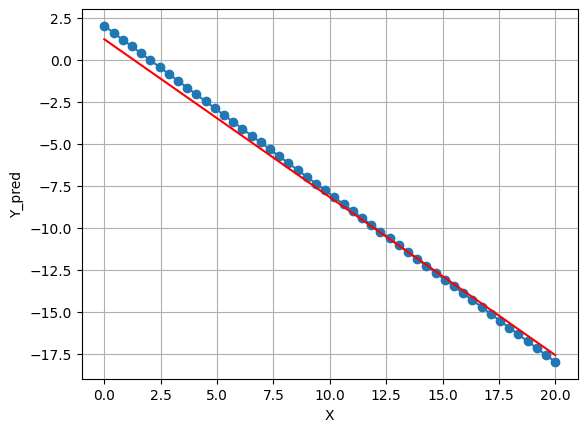

In [ ]:
plot_best_reg(X, y, hypos)

## Congratulations 
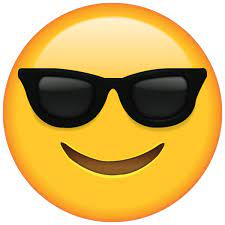